# Exploring ENVI binary data

author = ['Marshall Worsham'] <br>
date = 11-02-2020

---
## Libraries

In [2]:
# installs
#!pip3 install spectral
#!pip3 install liblas
#!pip3 install laspy
#!pip3 install gdecomp

# libraries
from spectral import *
import numpy as np
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import laspy
import gdecomp
import scipy.signal
import pandas as pd
import geopandas as gpd
#import liblas
#from liblas import file

---
## Opening ENVI files
Data from the 2018 NEON assignable asset acquisition are in LAS and flat (ENVI) binary files. They can be easily read with IDL, Matlab, or as we've done below, Python

### Local path

In [3]:
# local path to sample binary files
#neon_binary_path = '/Users/hmworsham/Desktop/RMBL/Projects/Watershed_Spatial_Dataset/Source/NEON_Binary_2018/2018_CRBU_1_2018061214_FL001'
neondir = os.sep.join(['/Volumes', 'Brain', 'GIS', 'RMBL', 'NEON_AOP_2018', 'Waveform_Lidar', 'Binary'])

In [4]:
flightpath = '2018061914_FL004'
neon_binary_path = os.sep.join([neondir, '2018_CRBU_1_' + flightpath])

### Geolocation array
Geolocation arrays are 2D arrays of double float values. Each has 16 columns and n rows, where n is the number of laser pulses fired in the set (e.g. 452328 for FL001). The waveform processor interprets the first return in each waveform (usually the first peak in the distribution) and geolocates it precisely. For other time bins, we can use the information in the geolocation array to find the coordinates.

Columns:

0. Easting of first return (m)
1. Northing of first return (m)
2. Height of first return (m)
3. dx (m)
4. dy (m)
5. dz (m)
6. Outgoing pulse reference bin location: index of the leading edge 50% point of outgoing pulse
7. First return reference bin location: index of the leading edge 50% point of outgoing pulse
8. Easting of return bin 0 (m)
9. Northing of return bin 0 (m)
10. Height of bin 0 (m)
11. dx (m)
12. dy (m)
13. dz (m)
14. Outgoing pulse peak reference bin location: index of outgoing pulse peak
15. Return bin 0 reference location: index of return bin 0... so 0

In [5]:
# open geolocation array
geolocation_path = os.sep.join([neon_binary_path, '2018_CRBU_1_'+ flightpath + '_waveform_geolocation_array_img.hdr'])
geo_pulse = open_image(geolocation_path)
geo_open = geo_pulse.open_memmap(writeable=True)

# print the geolocation array for one waveform
print(geo_open[0])

## check shape of geolocation array
print(geo_open.shape)

[[ 3.26680169e+05]
 [ 4.29886379e+06]
 [ 3.22741874e+03]
 [-5.10709465e-02]
 [ 3.85055377e-03]
 [-1.40840439e-01]
 [ 2.11000004e+01]
 [ 2.28999996e+01]
 [ 3.26681589e+05]
 [ 4.29886368e+06]
 [ 3.23133410e+03]
 [-5.10708836e-02]
 [ 3.85054900e-03]
 [-1.40840451e-01]
 [ 2.60000000e+01]
 [ 0.00000000e+00]]
(19693958, 16, 1)


### Return array
Return arrays are 2D arrays of waveform return pulses. Each has 500 columns and n rows, where n is the number of laster pulses fired in the set (452328 for FL001). The values in each observation represent pulse intensity values binned at nanosecond timestamps. Each pulse is divided up into 500 1-nanosecond time bins. 

**A note on pre-processing**
The raw return data are cropped into multiple segments using an intensity-threshold trigger, so each pulse doesn't necessarily have the same number of valid return data bins. The waveform processor uses time tag information to piece back together the (temporally inconsistent) segments so that what we end up with is a single array with 500 bins. One bin corresponds to 1 ns, which captures a range resolution of about 0.15m. 500 bins can hold roughly 75m of contiguous (though not fully *continuous*) range data.

The bin range that holds actual return intensity data varies across waveforms. So the arrays are zero-padded. Most of these zero values occur after the last return and can be taken to mark the last return in the waveform distribution.

In [6]:
# open return array
return_path =os.sep.join([neon_binary_path, '2018_CRBU_1_' + flightpath + '_waveform_return_pulse_array_img.hdr'])
return_pulse = open_image(return_path)
return_open = return_pulse.open_memmap(writeable=True)

## check shape of return array
len(return_open)
print(return_open.shape)

(19693958, 500, 1)


In [7]:
# explore some intensity values
wf0 = return_open[0]

peaki = wf0.argmax()
halfpeaki = round(peaki/2)
print(wf0[halfpeaki])

peak = wf0.max()
init = wf0[0]
intensity = peak - init
print(intensity)

halfpeak = (peak - init)/2 + init
print(halfpeak)
print(wf0[np.isclose(wf0, halfpeak, atol=1)])

[222]
[171]
[295.5]
[295]


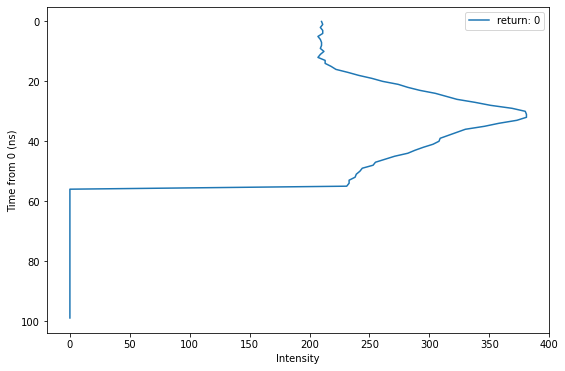

In [8]:
# plot some return arrays
fig = plt.figure(figsize = [9,6])
for i in np.arange(1):
    plt.plot(return_open[i][:100], np.arange(100), label = ('return: ' + str(i)))
    plt.xlabel('Intensity')
    plt.ylabel('Time from 0 (ns)')
    plt.gca().invert_yaxis()
    plt.legend();

### Outgoing pulse array

(19693958, 100, 1)


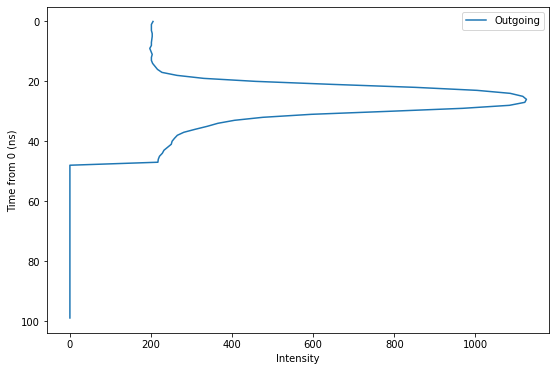

In [9]:
# open outgoing pulse array
fig = plt.figure(figsize = [9,6])
out_path = os.sep.join([neon_binary_path, '2018_CRBU_1_' + flightpath + '_waveform_outgoing_pulse_array_img.hdr'])
out_pulse = open_image(out_path)
out_open = out_pulse.open_memmap(writeable=True)
out_open
print(out_open.shape)

plt.plot(out_open[0], np.arange(100), label = 'Outgoing')
plt.xlabel('Intensity')
plt.ylabel('Time from 0 (ns)')
plt.gca().invert_yaxis()
plt.legend();

### Observation array
This array holds 12 observation values for each waveform. They are:

0. GPS week time (s)
1. Scan mirror angle (deg)
2. To-sensor azimuth angle (deg)
3. To-sensor zenith (deg)
4. Time of flight to first return (ns)
5. Range to first return (m)
6. Beam diameter at first return (m)
7. Time interval to waveform segment (ns): time interval from first bin of outgoing pulse to first bin of return pulse
8. Outgoing pulse dark offset (DN)
9. Return waveform dark offset (DN)
10. First return intensity (DN): intensity of first return after dark offset subtraction
11. Integrated intensity (DN): area under curve after dark offset subtraction

The waveform processor identifies what it thinks is the first return and then rigorously geolocates those first returns onto Earth's surface. These values are listed in the observation file. 

In [10]:
# open observation array
obs_path = os.sep.join([neon_binary_path, '2018_CRBU_1_' + flightpath + '_waveform_observation_array_img.hdr'])
obs_array = open_image(obs_path)
obs_open = obs_array.open_memmap(writeable = True)

# examine one waveform entry
print(obs_open.shape)
obs_open[0]

(19693958, 12, 1)


memmap([[2.30663167e+05],
        [1.55718832e+01],
        [9.43117246e+01],
        [1.99835356e+01],
        [7.09802500e+03],
        [1.06329515e+03],
        [8.50636169e-01],
        [7.09622500e+03],
        [2.01749969e+02],
        [2.09735489e+02],
        [1.64264511e+02],
        [3.35481250e+03]])

### Impulse Response
To deconvolve the return waveform, we'll need some estimate of the impulse response curve to remove the effects of the outgoing pulse shape. This is typically a lab-validated measurement, but the impulse response in this dataset was field-calibrated by shooting the laser off a ground-controlled mirror at nadir. This is close to, but not exactly the true system impulse response, because it's a raw return.  

#### Return impulse response function

(1, 100, 1)


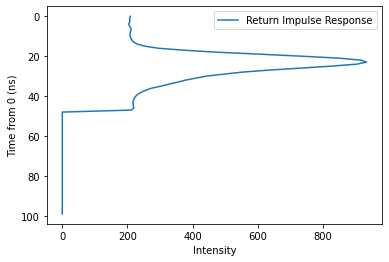

In [11]:
ir_path = os.sep.join([neon_binary_path, '2018_CRBU_1_2018061914_waveform_impulse_response_img.hdr'])
ir_array = open_image(ir_path)
ir_open = ir_array.open_memmap(writeable = True)

# examine one impulse response entry
print(ir_open.shape)
ir_open[0]

plt.plot(ir_open[0], np.arange(100), label = 'Return Impulse Response')
plt.xlabel('Intensity')
plt.ylabel('Time from 0 (ns)')
plt.gca().invert_yaxis()
plt.legend();

#### Outgoing pulse corresponding to system return impulse response function
The corresponding outgoing pulse of the return impulse function is provided in case the user wants to deconvolve the outgoing pulse and get closer to the true system response function.

(1, 100, 1)


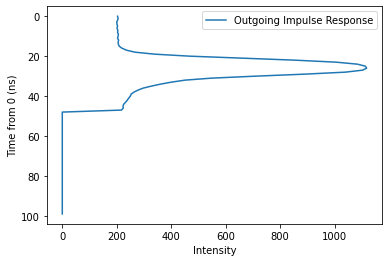

In [12]:
ir0_path = os.sep.join([neon_binary_path, '2018_CRBU_1_2018061914_waveform_impulse_response_T0_img.hdr'])
ir0_array = open_image(ir0_path)
ir0_open = ir0_array.open_memmap(writeable = True)

# examine one impulse response entry
print(ir0_open.shape)
ir0_open[0]

plt.plot(ir0_open[0], np.arange(100), label = 'Outgoing Impulse Response')
plt.xlabel('Intensity')
plt.ylabel('Time from 0 (ns)')
plt.gca().invert_yaxis()
plt.legend();

---
## Calculate coordinates of all other bins

### Calculation of bin geolocations

* New Easting = (desired return data bin position – first return reference bin location) * dx + Easting of first return
* New Northing = (desired return data bin position – first return reference bin location) * dy + Northing of first return
* New Height = (desired return data bin position – first return reference bin location) * dz + Height of first return

**Note** 
This accurately estimates the geolocation of all bins based on the first return coordinates. However, there is one subtlety to be aware of. The geolocation of the first return reference bin is based on leading edge detection, not on the first-return start or peak. Leading edge detection finds the bin (point in time) where the first return reaches 50% intensity on its leading edge. 

![image](leading_edge_detection.png)

To find accurate locations of other return objects, we will need to identify those return objects (e.g. by their peaks), and then find the leading-edge 50% intensity position of each, and calculate the coordinates of those positions. 

If we apply deconvolution and decomposition, it might be better to use the outgoing-pulse geolocation and dx, dy, dz values, which are defined by the peak of the outgoing pulse, not the leading-edge 50% position. In this case, a peak to peak bin geolocation calculation will work fine.

However, if we use the first return geolocation values but want to geolocate other objects based on their peaks, the new calculation would involve a slight modification to adjust from the leading edge to peak of the outgoing pulse: 

* New Easting = [(desired return data bin position – first return reference bin location) – (T0 peak location – T0 reference bin location)] * dx + Easting of first return
* New Northing = [(desired return data bin position – first return reference bin location) – (T0 peak location – T0 reference bin location)] * dy + Northing of first return
* New Height = [(desired return data bin position – first return reference bin location) – (T0 peak location – T0 reference bin location)] * dz + Height of first return


In [13]:
# gather inputs to calculate coordinates of other bins
# the [:1000] subsetting is to make array sizes manageable for testing; need to figure out a faster way to process

# get coordinates of first return of all waveforms
fr_x = geo_open[:120, 0] # get easting of first returns
fr_y = geo_open[:120, 1] # get northing of first returns
fr_z = geo_open[:120, 2] # get height of first returns

# get bin location of first return of all waveforms
fr_binloc = geo_open[:120, 7] 

# get [dx,dy,dz] to map pulse direction
dy = geo_open[:120, 4]
dx = geo_open[:120, 3]
dz = geo_open[:120, 5]

# make an array populated with bin positions for calculating coordinates at those positions
bins = [[i] for i in np.arange(500)]
bins_array = np.full((len(fr_x), 500, 1), bins)

# check that the shapes of the array of bin values and the return array are the same
assert bins_array.shape == return_open[:120].shape

In [14]:
# some checks
print(fr_x.shape)
print(fr_binloc.shape)
print(dx.shape)
assert dx.shape == dy.shape == dz.shape
print(bins_array.shape)

(120, 1)
(120, 1)
(120, 1)
(120, 500, 1)


#### Calculate coordinates in a naive way

In [15]:
# naive calculation for all bins
coord_ls = []

for rwf, j in zip(bins_array, np.arange(len(bins_array))):
    new_x = ((rwf - fr_binloc[j]) * dx[j] + fr_x[j]).squeeze()
    new_y = ((rwf - fr_binloc[j]) * dy[j] + fr_y[j]).squeeze()
    new_z = ((rwf - fr_binloc[j]) * dz[j] + fr_z[j]).squeeze()
    new_coords = np.array([new_x, new_y, new_z]).T
    coord_ls.append(new_coords)

# convert list to array
coord_array = np.array(coord_ls)

In [16]:
# check the shape of coord_array is (120, 500, 3)
assert coord_array.shape == (120, 500, 3)

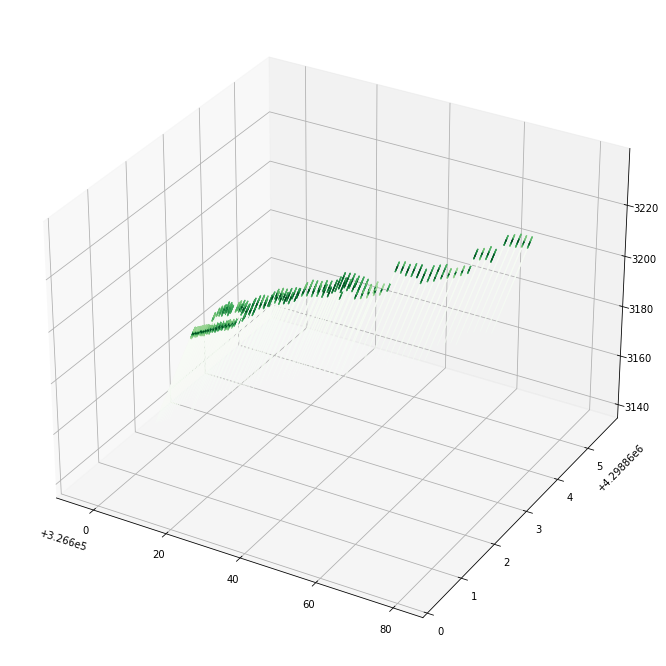

In [17]:
# plot the waveforms with color mapped to intensity
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(111, projection='3d')
for i in np.arange(120):
    ax.scatter(coord_array[i][:,0], coord_array[i][:,1], coord_array[i][:,2], c = return_open[i], cmap = 'Greens', s=0.1)
#plt.savefig('pyenvi_test.png')

---
## Select area around Scho-24

In [18]:
invplotdir = '/Users/hmworsham/Desktop/RMBL/Projects/Watershed_Spatial_Dataset/Output/Kueppers_Plot_Bnd_2020_WGS84UTM13N'
scho19 = gpd.read_file(os.sep.join([invplotdir, 'Scho19_PlotCenter_WGS84UTM13N.shp']))

In [19]:
scho19_poly = gpd.read_file(os.sep.join([invplotdir, 'Scho19_Bound_poly_WGS84UTM13N.shp']))

In [20]:
s19minx = scho19_poly.bounds.minx.squeeze()
s19maxx = scho19_poly.bounds.maxx.squeeze()
s19miny = scho19_poly.bounds.miny.squeeze()
s19maxy = scho19_poly.bounds.maxy.squeeze()

In [34]:
scho19_buff = scho19_poly.buffer(50)
scho19_buff_gpdf = gpd.GeoDataFrame({'geometry': scho19_buff.values}, {'plot':0})

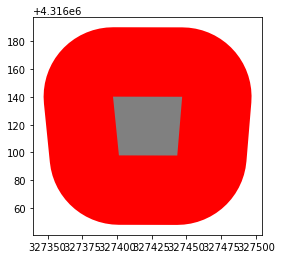

In [35]:
ax = scho19_buff_gpdf.plot(color='red')
scho19_poly.plot(ax = ax, color = 'grey');

In [36]:
minx = scho19_buff.bounds.minx.squeeze()
miny = scho19_buff.bounds.miny.squeeze()
maxx = scho19_buff.bounds.maxx.squeeze()
maxy = scho19_buff.bounds.maxy.squeeze()

In [37]:
xy_array = geo_open[:,:2]
xy_array[:,0].squeeze()

array([326680.1688261 , 326679.59110389, 326679.45664727, ...,
       327844.94900313, 327843.74366875, 327842.53891317])

In [38]:
scho19_geos = geo_open[(xy_array[:,0].squeeze() >= minx) & (xy_array[:,0].squeeze() <= maxx) & (xy_array[:,1].squeeze() >= miny) & (xy_array[:,1].squeeze() <= maxy)]

scho19_returns = return_open[(xy_array[:,0].squeeze() >= minx) & (xy_array[:,0].squeeze() <= maxx) & (xy_array[:,1].squeeze() >= miny) & (xy_array[:,1].squeeze() <= maxy)]

scho19_outs = out_open[(xy_array[:,0].squeeze() >= minx) & (xy_array[:,0].squeeze() <= maxx) & (xy_array[:,1].squeeze() >= miny) & (xy_array[:,1].squeeze() <= maxy)]

In [39]:
# gather inputs to calculate coordinates of other bins
# the [:1000] subsetting is to make array sizes manageable for testing; need to figure out a faster way to process

# get coordinates of first return of all waveforms
fr_x = scho19_geos[:, 0] # get easting of first returns
fr_y = scho19_geos[:, 1] # get northing of first returns
fr_z = scho19_geos[:, 2] # get height of first returns

# get bin location of first return of all waveforms
fr_binloc = scho19_geos[:, 7] 

# get [dx,dy,dz] to map pulse direction
dy = scho19_geos[:, 4]
dx = scho19_geos[:, 3]
dz = scho19_geos[:, 5]

# make an array populated with bin positions for calculating coordinates at those positions
bins = [[i] for i in np.arange(500)]
bins_array = np.full((len(fr_x), 500, 1), bins)

# check that the shapes of the array of bin values and the return array are the same
assert bins_array.shape == scho19_returns.shape

In [40]:
# naive calculation for all bins
coord_ls = []

for rwf, j in zip(bins_array, np.arange(len(bins_array))):
    new_x = ((rwf - fr_binloc[j]) * dx[j] + fr_x[j]).squeeze()
    new_y = ((rwf - fr_binloc[j]) * dy[j] + fr_y[j]).squeeze()
    new_z = ((rwf - fr_binloc[j]) * dz[j] + fr_z[j]).squeeze()
    new_coords = np.array([new_x, new_y, new_z]).T
    coord_ls.append(new_coords)

# convert list to array
coord_array = np.array(coord_ls)

In [41]:
coord_array.shape

(9802, 500, 3)

In [31]:
# plot the waveforms with color mapped to intensity
fig = plt.figure(figsize = (12,12))
ax = fig.add_subplot(111, projection='3d')
for i in range(len(coord_array)):
    ax.scatter(coord_array[i][:,0], coord_array[i][:,1], coord_array[i][:,2], c = scho19_returns[i], cmap = 'Greens', s=0.1)
#plt.savefig('pyenvi_test.png')

Error in callback <function flush_figures at 0x110195700> (for post_execute):


KeyboardInterrupt: 

## Gaussian Decomposition
Here we can apply a Gaussian decomposition to portray the waveform as a sum of Gaussian functions. This helps to de-noise and smooth the return signal. Peaks that result from the decomposition can be taken as return objects. 

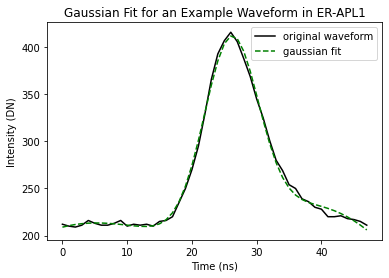

In [168]:
testdata = np.array(scho19_returns[232].flatten())

testdata = np.array([float(i) for i in testdata])
testdata = np.trim_zeros(testdata)
x = np.arange(len(testdata))

out = gdecomp.GaussianDecomposition(testdata)
out = np.reshape(out, (-1, 3))

fit = np.zeros(testdata.size)
for i in np.arange(len(out)):
    fit += out[i,0] / (np.sqrt(2 * np.pi)*out[i,2]) * np.exp(-(x - out[i,1])**2 / (2 * out[i,2]**2))

waveform = plt.plot(x, testdata, color = 'k', label = 'original waveform')
gaussfit = plt.plot(x, fit, color = 'green', label = 'gaussian fit', linestyle = '--')
plt.title('Gaussian Fit for an Example Waveform in ER-APL1')
plt.xlabel('Time (ns)')
plt.ylabel('Intensity (DN)')
plt.legend();

In [136]:
scho19_returns.shape

(867, 500, 1)

In [154]:
scho19_raw = np.empty((867,500))
for ret in range(scho19_returns.shape[0]):
    flat = scho19_returns[ret,:].flatten()
    trim = np.trim_zeros(flat)
    np.append(scho19_raw, trim)

scho19_raw
# out = []
# for ret in scho19_raw:
#     decom = gdecomp.GaussianDecomposition(scho19_raw)
#     out.append([decom])

# out = np.reshape(out, (-1, 3))

array([[214., 215., 211., ...,   0.,   0.,   0.],
       [238., 229., 233., ...,   0.,   0.,   0.],
       [213., 213., 213., ...,   0.,   0.,   0.],
       ...,
       [218., 219., 219., ...,   0.,   0.,   0.],
       [226., 226., 221., ...,   0.,   0.,   0.],
       [208., 207., 207., ...,   0.,   0.,   0.]])

## Deconvolution

In [236]:
deconvolution(ret_12, out_12, impres_12, impout_12, method = 'Gold')

TypeError: type numpy.ndarray doesn't define __round__ method

## N Peaks

In [13]:
def embed(series, span):
    span_indices = np.flip(np.arange(span))
    embed_array = []
    for j in np.arange(len(series))[span:]:
        embed_s = series[j-span:j]
        embed_s.reverse()
        embed_array.append(embed_s)

    return embed_array

In [39]:
def lpeak(series, span = 3):
    '''
    @param series is the input a numeric vector.
#' @param span is the length or interval of peak finding cell, default is 3.
#' @return return a boolean type data corresponding to the numeric vector.
'''
    series = [float(i) for i in series]
    z = embed(series, span)
    s = span // 2
    v = np.argmax(z, axis = 1) == s
    falses = np.full(s, False)
    result = np.append(falses, v)
    result = result[:(len(result)-s)]
    return result

In [17]:
# find local maxima on gaussians
fit[np.r_[True, fit[1:] > fit[:-1]] & np.r_[fit[:-1] > fit[1:], True]]

array([230.15445496, 329.05520229])

## LAS processing
The data package includes a LAS file for QC, which contains the first returns as derived by the Optech waveform processor. The LAS file can be used for visual reference and QC to check for errors in GPS time or instrument telemetry. The projection is UTM Zone 13N WGS-84.

### Open the las file

In [32]:
# open first-return las with laspy
las_file = os.sep.join([neon_binary_path, '2018_CRBU_1_2018061214_FL001_waveform_first_return.las'])
input_las = laspy.file.File(las_file, mode="r")
point_records = input_las.points.copy()

### Pull scaling and offset parameters from the header and calculate coordinates

In [238]:
# get scaling and offset parameters
las_scaleX = input_las.header.scale[0]
las_offsetX = input_las.header.offset[0]
las_scaleY = input_las.header.scale[1]
las_offsetY = input_las.header.offset[1]
las_scaleZ = input_las.header.scale[2]
las_offsetZ = input_las.header.offset[2]

# calculate coordinates
p_X = np.array((point_records['point']['X'] * las_scaleX) + las_offsetX)
p_Y = np.array((point_records['point']['Y'] * las_scaleY) + las_offsetY)
p_Z = np.array((point_records['point']['Z'] * las_scaleZ) + las_offsetZ)

# check a few coordinates
print(p_X[:5], p_Y[:5], p_Z[:5])

[336130.56 336129.47 336126.69 336122.82 336114.8 ] [4310299.79 4310300.19 4310301.25 4310302.54 4310305.15] [3202.63 3204.13 3209.78 3208.9  3202.65]


### Plot points in 3D

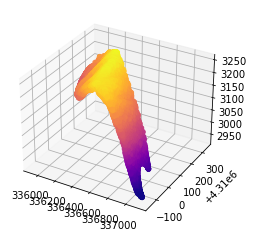

In [124]:
# plot first-return points in 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
#ax.scatter(p_X, p_Y, p_Z, cmap = 'viridis', c='red', marker = 'o')
ax.scatter(p_X[:28500], p_Y[:28500], p_Z[:28500], c = p_Z[:28500], cmap = 'plasma', marker='o', alpha = 0.7)
plt.show()

### Plot points in 2D

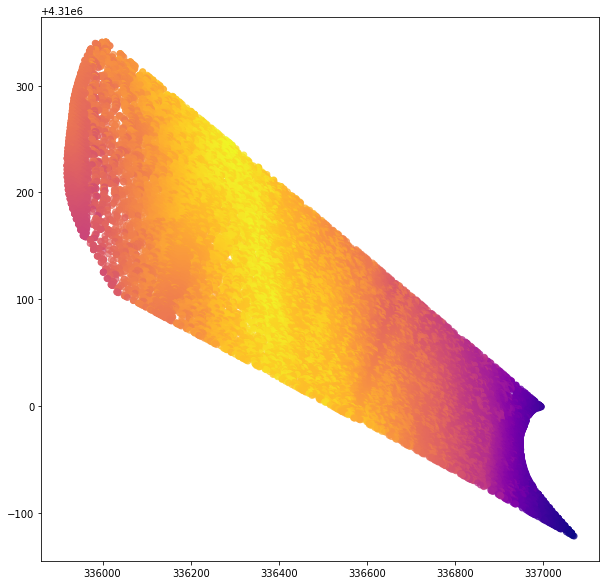

In [128]:
# plot first-return points in 2D
fig = plt.figure(figsize=[10,10])
ax = fig.add_subplot(111)
ax.scatter(p_X[:25000], p_Y[:25000], c = p_Z[:25000], cmap = 'plasma', marker = 'o', alpha = 0.7)
plt.show()

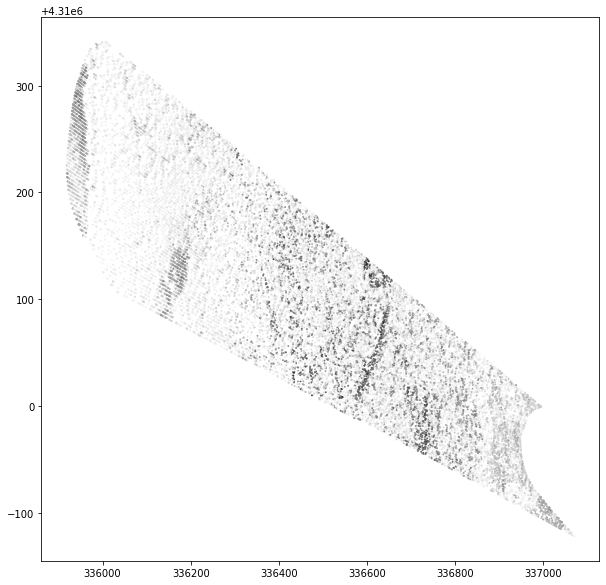

In [144]:
# plot first-return points with first-return intensity

# first-return intensity
fri = obs_open[:,10]

# plot
fig = plt.figure(figsize=[10,10])
ax = fig.add_subplot(111)
ax.scatter(p_X[:25000], p_Y[:25000], c = fri[:25000], cmap = 'Greys', marker = 'o', alpha = 0.7, s = 1)
plt.show()

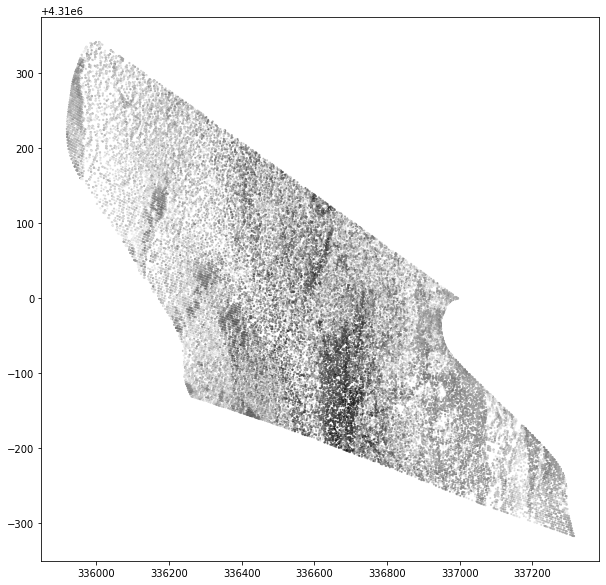

In [146]:
# plot first-return points with integrated intensity

# integrated intensity
fri = obs_open[:,11]

# plot
fig = plt.figure(figsize=[10,10])
ax = fig.add_subplot(111)
ax.scatter(p_X[:50000], p_Y[:50000], c = fri[:50000], cmap = 'Greys', marker = 'o', alpha = 0.7, s = 1)
plt.show()

## Save an image

In [ ]:
#envi.save_image('new_image.bsq', ext='bsq', interleave='BSQ')